In [48]:
from models import BlackScholes, MonteCarlo, Heston, Dupire, SABR
from calibration import Calibration
from visualization.graphics import Graphics
import datetime as dt
import pandas as pd
import numpy as np

In [49]:
ticker = '^SPX'
end  = dt.datetime.now()
start = end - dt.timedelta(days=180) # 180 days is common when you consider the volatility constant
calibration = Calibration(ticker, start, end)

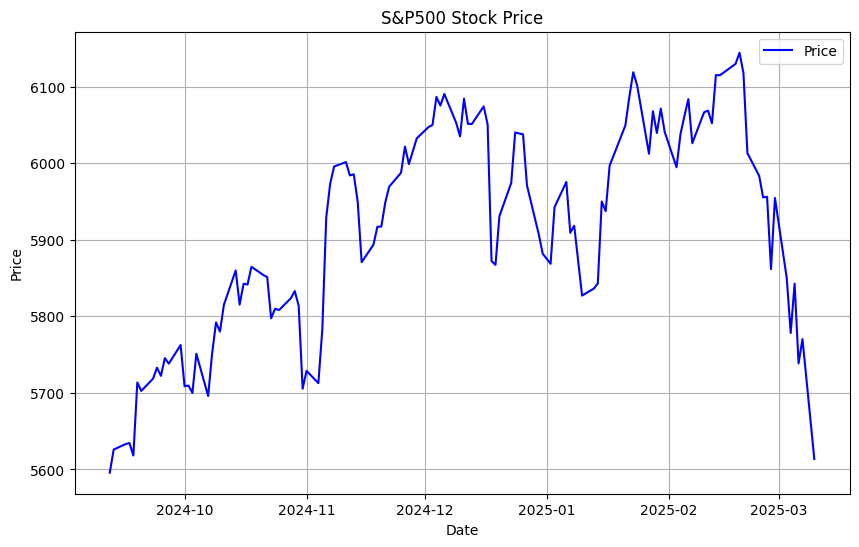

In [50]:
spx_historical_prices = calibration.get_historical_prices_df()
# Initialize Graphics class
graphics = Graphics()
# Plot stock chart
graphics.plot_stock_chart(spx_historical_prices, 'S&P500')

In [51]:
S0 = calibration.get_latest_price()
S0 # Current price of the underlying asset

5613.77

In [52]:
K = S0 # Strike price
T = 1  # Time to maturity (1 year)

In [53]:
hist_mu = calibration.get_historical_mu()
hist_sigma = calibration.get_historical_sigma()
r = calibration.get_risk_free_rate()
print(f"Historical mu: {hist_mu}, Historical sigma: {hist_sigma}, Risk free rate: {r}")

Historical mu: 0.0093, Historical sigma: 0.1363, Risk free rate: 0.0418


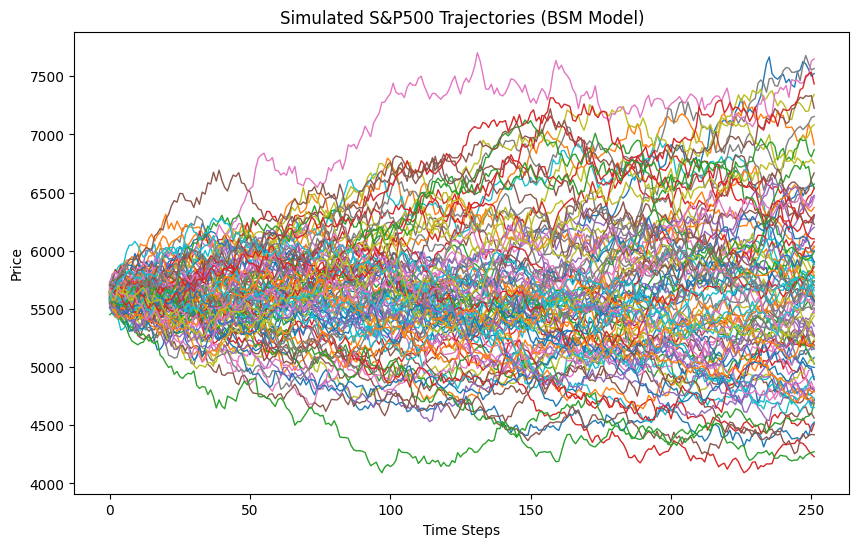

In [54]:
import numpy as np
import matplotlib.pyplot as plt

def simulate_gbm(S0, mu, sigma, T, dt, n_simulations):
    """
    Simulate geometric Brownian motion trajectories.

    Parameters:
        S0 : float - Initial stock price
        mu : float - Drift (expected return)
        sigma : float - Volatility
        T : float - Time horizon (in years)
        dt : float - Time step (in years)
        n_simulations : int - Number of simulations

    Returns:
        numpy.ndarray: Simulated price paths (n_simulations x time_steps)
    """
    n_steps = int(T / dt)
    t = np.linspace(0, T, n_steps)
    W = np.random.standard_normal(size=(n_simulations, n_steps))
    W = np.cumsum(W, axis=1) * np.sqrt(dt)  # Cumulative sum to simulate Brownian motion
    drift = (mu - 0.5 * sigma**2) * t
    diffusion = sigma * W
    S = S0 * np.exp(drift + diffusion)
    return S

# Parameters
S0 = calibration.get_latest_price()  # Initial price
mu = hist_mu  # Historical drift
sigma = hist_sigma  # Historical volatility
T = 1  # Time horizon (1 year)
dt = 1/252  # Time step (assuming 252 trading days in a year)
n_simulations = 100  # Number of simulations

# Simulate trajectories
simulated_paths = simulate_gbm(S0, mu, sigma, T, dt, n_simulations)

# Plot simulated trajectories
plt.figure(figsize=(10, 6))
for i in range(n_simulations):
    plt.plot(simulated_paths[i], lw=1)
plt.title('Simulated S&P500 Trajectories (BSM Model)')
plt.xlabel('Time Steps')
plt.ylabel('Price')
plt.show()

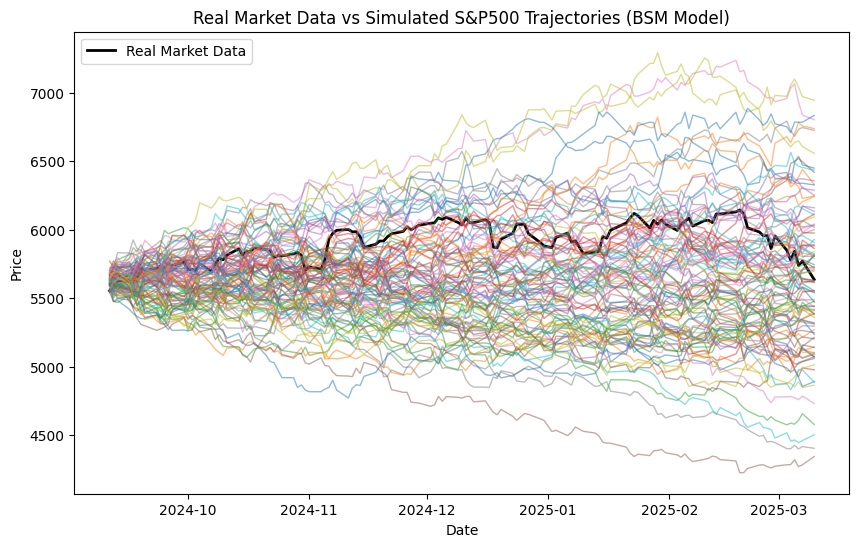

In [16]:
# Get real market data
real_prices = spx_historical_prices['Close'].values
real_dates = spx_historical_prices.index

# Trim simulated paths to match the length of historical data
trimmed_simulated_paths = simulated_paths[:, :len(real_dates)]

# Plot real market data and simulated trajectories
plt.figure(figsize=(10, 6))
plt.plot(real_dates, real_prices, label='Real Market Data', color='black', lw=2)

# Plot simulated trajectories
for i in range(n_simulations):
    plt.plot(real_dates, trimmed_simulated_paths[i], lw=1, alpha=0.5)

plt.title('Real Market Data vs Simulated S&P500 Trajectories (BSM Model)')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.show()

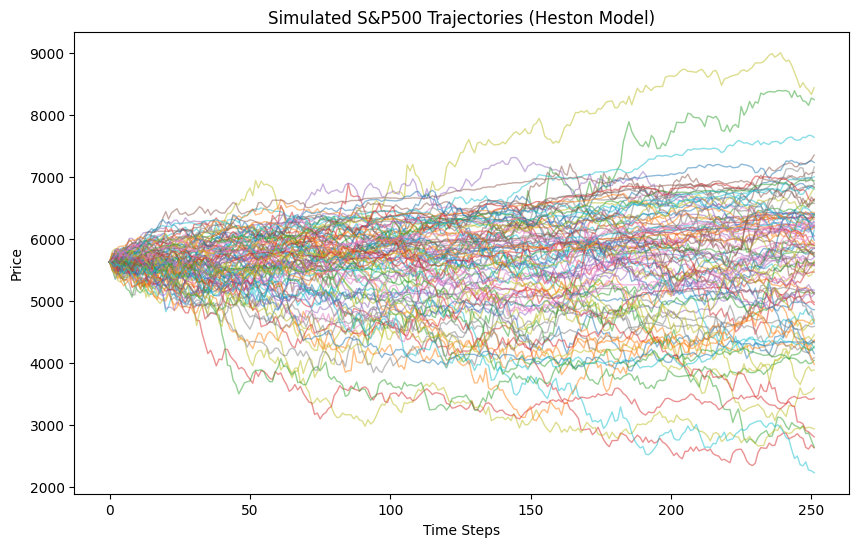

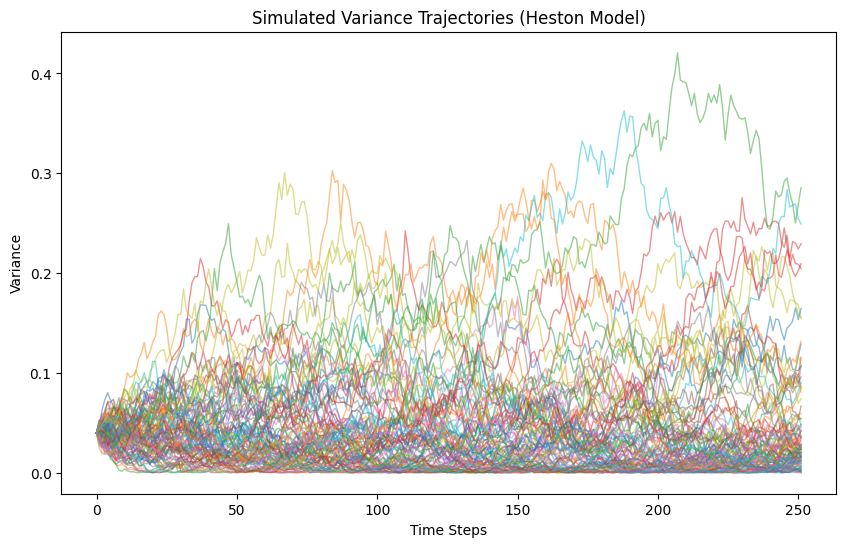

In [17]:
import numpy as np
import matplotlib.pyplot as plt

def simulate_heston(S0, v0, mu, kappa, theta, sigma, rho, T, dt, n_simulations):
    """
    Simulate trajectories using the Heston stochastic volatility model.

    Parameters:
        S0 : float - Initial asset price
        v0 : float - Initial variance
        mu : float - Drift of the asset price
        kappa : float - Mean reversion rate of variance
        theta : float - Long-term average variance
        sigma : float - Volatility of volatility
        rho : float - Correlation between asset price and variance
        T : float - Time horizon (in years)
        dt : float - Time step (in years)
        n_simulations : int - Number of simulations

    Returns:
        tuple: (S_t, v_t) - Simulated asset prices and variances
    """
    n_steps = int(T / dt)
    S = np.zeros((n_simulations, n_steps))
    v = np.zeros((n_simulations, n_steps))
    S[:, 0] = S0
    v[:, 0] = v0

    # Generate correlated Brownian motions
    W_S = np.random.standard_normal(size=(n_simulations, n_steps))
    W_v = rho * W_S + np.sqrt(1 - rho**2) * np.random.standard_normal(size=(n_simulations, n_steps))

    for t in range(1, n_steps):
        # Update variance (ensure it remains positive)
        v[:, t] = np.maximum(v[:, t-1] + kappa * (theta - v[:, t-1]) * dt + sigma * np.sqrt(v[:, t-1]) * np.sqrt(dt) * W_v[:, t], 0)
        # Update asset price
        S[:, t] = S[:, t-1] * np.exp((mu - 0.5 * v[:, t-1]) * dt + np.sqrt(v[:, t-1]) * np.sqrt(dt) * W_S[:, t])

    return S, v

# Parameters
S0 = calibration.get_latest_price()  # Initial asset price
v0 = 0.04  # Initial variance
mu = hist_mu  # Drift of the asset price
kappa = 2.0  # Mean reversion rate of variance
theta = 0.04  # Long-term average variance
sigma = 0.5  # Volatility of volatility
rho = -0.7  # Correlation between asset price and variance
T = 1  # Time horizon (1 year)
dt = 1/252  # Time step (assuming 252 trading days in a year)
n_simulations = 100  # Number of simulations

# Simulate Heston trajectories
S, v = simulate_heston(S0, v0, mu, kappa, theta, sigma, rho, T, dt, n_simulations)

# Plot simulated asset price trajectories
plt.figure(figsize=(10, 6))
for i in range(n_simulations):
    plt.plot(S[i], lw=1, alpha=0.5)
plt.title('Simulated S&P500 Trajectories (Heston Model)')
plt.xlabel('Time Steps')
plt.ylabel('Price')
plt.show()

# Plot simulated variance trajectories
plt.figure(figsize=(10, 6))
for i in range(n_simulations):
    plt.plot(v[i], lw=1, alpha=0.5)
plt.title('Simulated Variance Trajectories (Heston Model)')
plt.xlabel('Time Steps')
plt.ylabel('Variance')
plt.show()

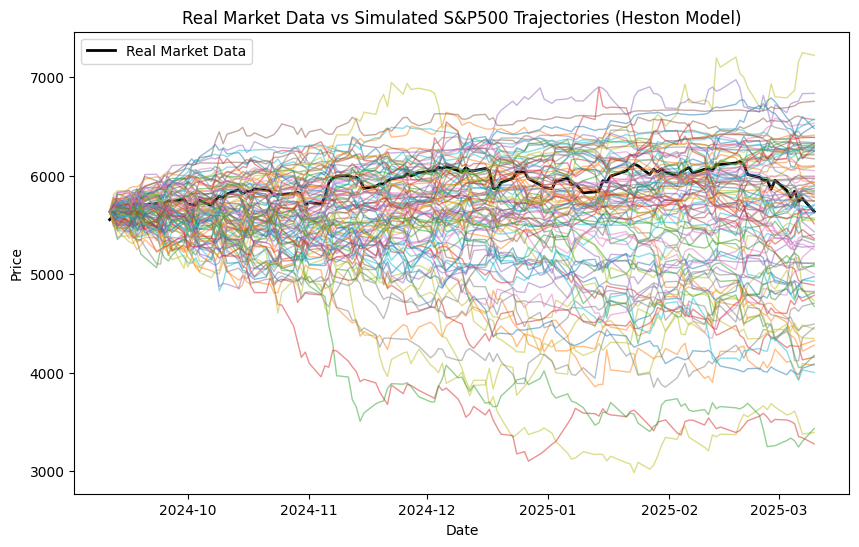

In [18]:
# Get real market data
real_prices = spx_historical_prices['Close'].values
real_dates = spx_historical_prices.index

# Trim simulated paths to match the length of historical data
trimmed_S = S[:, :len(real_dates)]

# Plot real market data and simulated trajectories
plt.figure(figsize=(10, 6))
plt.plot(real_dates, real_prices, label='Real Market Data', color='black', lw=2)

# Plot simulated trajectories
for i in range(n_simulations):
    plt.plot(real_dates, trimmed_S[i], lw=1, alpha=0.5)

plt.title('Real Market Data vs Simulated S&P500 Trajectories (Heston Model)')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.show()

In [19]:
import yfinance as yf
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm
from datetime import datetime

In [20]:
# Paramètres
ticker = "^SPX"  # Symbole de l'indice S&P500
expiration_date = "2026-03-20"  # Date d'expiration des options (à ajuster)

# Récupérer les données des options
spx = yf.Ticker(ticker)
options = spx.option_chain(expiration_date)

# Extraire les calls et les puts
calls = options.calls
puts = options.puts

# Afficher les premières lignes des calls
print(calls.head())

       contractSymbol             lastTradeDate  strike  lastPrice     bid  \
0  SPX260320C00200000 2024-12-20 10:43:35+00:00   200.0    5598.60  5736.9   
1  SPX260320C01400000 2025-01-16 18:27:20+00:00  1400.0    4562.00  4631.3   
2  SPX260320C02500000 2025-02-26 14:54:32+00:00  2500.0    3561.49  3180.7   
3  SPX260320C03100000 2025-02-26 14:39:00+00:00  3100.0    2984.07  2616.5   
4  SPX260320C04000000 2025-02-28 15:50:34+00:00  4000.0    2066.74  1793.8   

      ask  change  percentChange  volume  openInterest  impliedVolatility  \
0  5770.7     0.0            0.0     1.0             1           0.000000   
1  4817.1     0.0            0.0     NaN             1           1.744253   
2  3214.2     0.0            0.0     NaN             1           0.541192   
3  2651.4     0.0            0.0     NaN             1           0.492124   
4  1828.7     0.0            0.0     1.0             5           0.385605   

   inTheMoney contractSize currency  
0        True      REGULAR    

In [21]:
def implied_volatility(option_price, S, K, T, r, option_type="C", tol=1e-6, max_iter=100):
    """
    Calcule la volatilité implicite en utilisant la méthode de Newton-Raphson.

    Parameters:
        option_price : float - Prix de marché de l'option
        S : float - Prix de l'actif sous-jacent
        K : float - Prix d'exercice
        T : float - Temps jusqu'à l'échéance (en années)
        r : float - Taux sans risque
        option_type : str - Type d'option ("C" pour call, "P" pour put)
        tol : float - Tolérance pour la convergence
        max_iter : int - Nombre maximal d'itérations

    Returns:
        float - Volatilité implicite
    """
    sigma = 0.3  # Estimation initiale de la volatilité
    for _ in range(max_iter):
        bs = BlackScholes(r=r, S=S, K=K, T=T, sigma=sigma, option_type=option_type)
        price = bs.calculate_option_price()
        vega = bs.calculate_vega()  # Vega est la dérivée du prix par rapport à la volatilité

        # Mettre à jour sigma avec la méthode de Newton-Raphson
        diff = option_price - price
        if abs(diff) < tol:
            break
        sigma += diff / vega
    return sigma

In [22]:
# Paramètres
S0 = calibration.get_latest_price()  # Prix actuel de l'actif sous-jacent
r = calibration.get_risk_free_rate()  # Taux sans risque
T = (datetime.strptime(expiration_date, "%Y-%m-%d") - datetime.now()).days / 365  # Temps jusqu'à l'échéance

# Calculer la volatilité implicite pour chaque call
calls['Implied Volatility'] = calls.apply(
    lambda row: implied_volatility(
        option_price=row['lastPrice'],
        S=S0,
        K=row['strike'],
        T=T,
        r=r,
        option_type="C"
    ),
    axis=1
)

# Afficher les résultats
print(calls[['strike', 'lastPrice', 'Implied Volatility']].head())

   strike  lastPrice  Implied Volatility
0   200.0    5598.60                 NaN
1  1400.0    4562.00                 NaN
2  2500.0    3561.49                 NaN
3  3100.0    2984.07            0.737896
4  4000.0    2066.74            0.474752


/var/folders/hd/jlktn7px1bj_yxtds7vr27d00000gn/T/ipykernel_9840/2184148520.py:28: RuntimeWarning: divide by zero encountered in scalar divide
  sigma += diff / vega
/Users/jonathanlevel/Desktop/Scolaire/Supérieur/TSP/3A/PFE/Option_Pricing/models/black_scholes.py:35: RuntimeWarning: invalid value encountered in scalar divide
  d1 = (np.log(self.S / self.K) + (self.r + self.sigma**2 / 2) * self.T) / (self.sigma * np.sqrt(self.T))


In [23]:
# Paramètres
S0 = calibration.get_latest_price()  # Prix actuel de l'actif sous-jacent
r = calibration.get_risk_free_rate()  # Taux sans risque
T = (datetime.strptime(expiration_date, "%Y-%m-%d") - datetime.now()).days / 365  # Temps jusqu'à l'échéance

# Calculer la volatilité implicite pour chaque call
calls['Implied Volatility'] = calls.apply(
    lambda row: implied_volatility(
        option_price=row['lastPrice'],
        S=S0,
        K=row['strike'],
        T=T,
        r=r,
        option_type="C"
    ),
    axis=1
)

# Afficher les résultats
print(calls[['strike', 'lastPrice', 'Implied Volatility']].head())

   strike  lastPrice  Implied Volatility
0   200.0    5598.60                 NaN
1  1400.0    4562.00                 NaN
2  2500.0    3561.49                 NaN
3  3100.0    2984.07            0.737837
4  4000.0    2066.74            0.474707


/var/folders/hd/jlktn7px1bj_yxtds7vr27d00000gn/T/ipykernel_9840/2184148520.py:28: RuntimeWarning: divide by zero encountered in scalar divide
  sigma += diff / vega
/Users/jonathanlevel/Desktop/Scolaire/Supérieur/TSP/3A/PFE/Option_Pricing/models/black_scholes.py:35: RuntimeWarning: invalid value encountered in scalar divide
  d1 = (np.log(self.S / self.K) + (self.r + self.sigma**2 / 2) * self.T) / (self.sigma * np.sqrt(self.T))


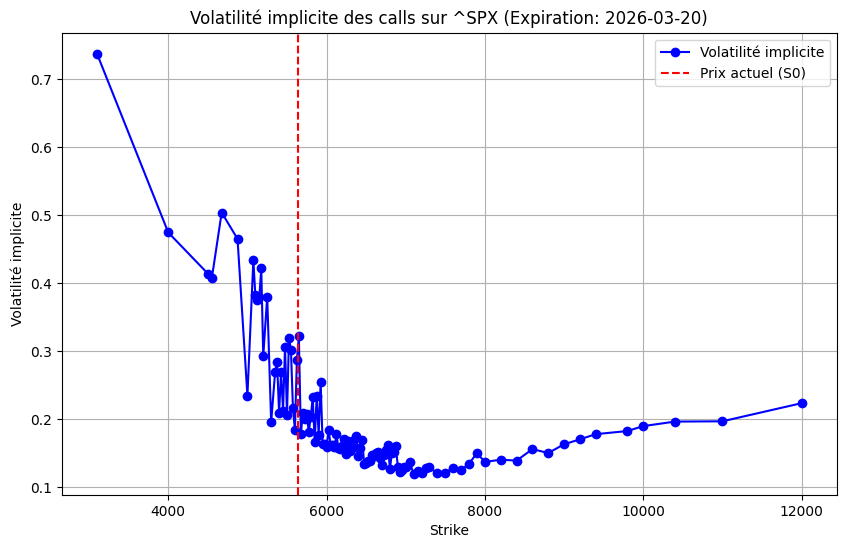

In [24]:
# Tracer la volatilité implicite
plt.figure(figsize=(10, 6))
plt.plot(calls['strike'], calls['Implied Volatility'], 'bo-', label='Volatilité implicite')
plt.axvline(x=S0, color='r', linestyle='--', label='Prix actuel (S0)')
plt.title(f'Volatilité implicite des calls sur {ticker} (Expiration: {expiration_date})')
plt.xlabel('Strike')
plt.ylabel('Volatilité implicite')
plt.legend()
plt.grid()
plt.show()

In [25]:
# Calculer la volatilité implicite du marché pour chaque call
calls['Market Implied Volatility'] = calls.apply(
    lambda row: implied_volatility(
        option_price=row['lastPrice'],
        S=S0,
        K=row['strike'],
        T=T,
        r=r,
        option_type="C"
    ),
    axis=1
)

/var/folders/hd/jlktn7px1bj_yxtds7vr27d00000gn/T/ipykernel_9840/2184148520.py:28: RuntimeWarning: divide by zero encountered in scalar divide
  sigma += diff / vega
/Users/jonathanlevel/Desktop/Scolaire/Supérieur/TSP/3A/PFE/Option_Pricing/models/black_scholes.py:35: RuntimeWarning: invalid value encountered in scalar divide
  d1 = (np.log(self.S / self.K) + (self.r + self.sigma**2 / 2) * self.T) / (self.sigma * np.sqrt(self.T))


In [26]:
# Utiliser la volatilité historique pour calculer les prix théoriques
hist_sigma = calibration.get_historical_sigma()

# Calculer les prix théoriques des options avec le modèle BSM
calls['BSM Theoretical Price'] = calls.apply(
    lambda row: BlackScholes(
        r=r,
        S=S0,
        K=row['strike'],
        T=T,
        sigma=hist_sigma,
        option_type="C"
    ).calculate_option_price(),
    axis=1
)

# Calculer la volatilité implicite théorique en utilisant les prix théoriques du BSM
calls['BSM Theoretical Implied Volatility'] = calls.apply(
    lambda row: implied_volatility(
        option_price=row['BSM Theoretical Price'],
        S=S0,
        K=row['strike'],
        T=T,
        r=r,
        option_type="C"
    ),
    axis=1
)

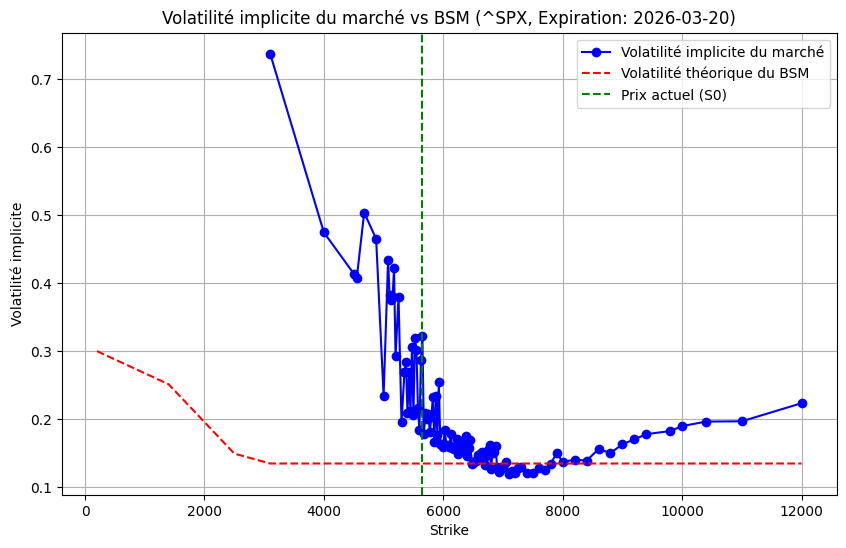

In [27]:
# Tracer les deux courbes
plt.figure(figsize=(10, 6))
plt.plot(calls['strike'], calls['Market Implied Volatility'], 'bo-', label='Volatilité implicite du marché')
plt.plot(calls['strike'], calls['BSM Theoretical Implied Volatility'], 'r--', label='Volatilité théorique du BSM')
plt.axvline(x=S0, color='g', linestyle='--', label='Prix actuel (S0)')
plt.title(f'Volatilité implicite du marché vs BSM ({ticker}, Expiration: {expiration_date})')
plt.xlabel('Strike')
plt.ylabel('Volatilité implicite')
plt.legend()
plt.grid()
plt.show()

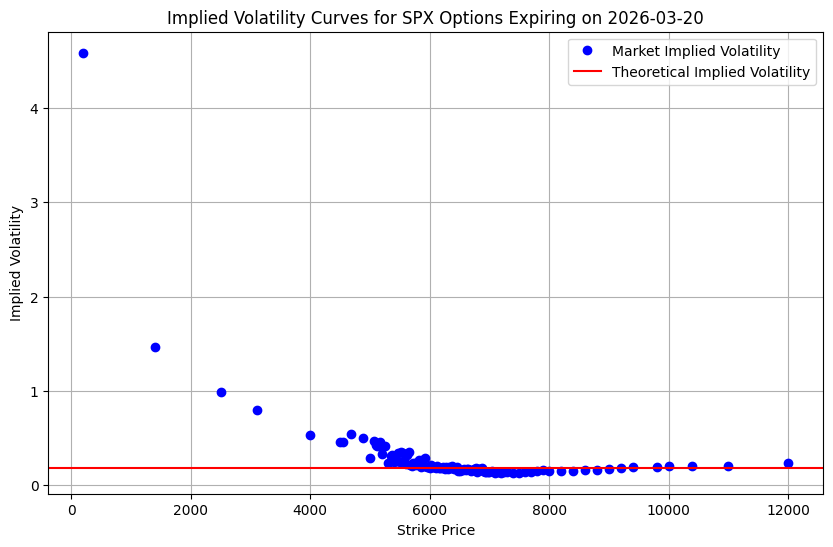

In [32]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import yfinance as yf
from scipy.optimize import brentq
from scipy.stats import norm

# Black-Scholes formula for European call option price
def black_scholes_call_price(S, K, T, r, sigma):
    d1 = (np.log(S / K) + (r + 0.5 * sigma**2) * T) / (sigma * np.sqrt(T))
    d2 = d1 - sigma * np.sqrt(T)
    return S * norm.cdf(d1) - K * np.exp(-r * T) * norm.cdf(d2)

# Function to calculate implied volatility
def implied_volatility(market_price, S, K, T, r):
    def objective_function(sigma):
        return black_scholes_call_price(S, K, T, r, sigma) - market_price
    
    try:
        # Check if we have opposite signs for root finding
        f_low = objective_function(1e-6)
        f_high = objective_function(5.0)
        
        if f_low * f_high > 0:
            raise ValueError("No root found within given bounds.")

        implied_vol = brentq(objective_function, 1e-6, 5.0)
        return implied_vol
    
    except ValueError:
        print(f"Warning: No implied volatility found for K={K}, market_price={market_price}")
        return np.nan

# Fetch SPX data from Yahoo Finance
ticker = "^SPX"  # S&P 500 index
spx = yf.Ticker(ticker)

# Get expiration dates and select the one we need
expirations = spx.options
target_expiration = "2026-03-20"

if target_expiration not in expirations:
    raise ValueError(f"Expiration {target_expiration} not found in available dates: {expirations}")

# Fetch option chain for the target expiration date
option_chain = spx.option_chain(target_expiration)
calls = option_chain.calls  # Get call options

# Extract necessary data
market_data = calls[['strike', 'lastPrice']].dropna().values.tolist()

# Get underlying SPX price
S = spx.history(period="1d")['Close'].iloc[-1]  # Latest SPX close price
r = 0.02  # Approximate risk-free rate (adjust if necessary)
T = (pd.Timestamp(target_expiration) - pd.Timestamp.today()).days / 365.25  # Time to expiration in years

# Calculate market implied volatilities
market_iv = []
strikes = []
for K, market_price in market_data:
    iv = implied_volatility(market_price, S, K, T, r)
    market_iv.append(iv)
    strikes.append(K)

# Theoretical implied volatility (assumed constant)
theoretical_iv = 0.18  # Example constant volatility

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(strikes, market_iv, 'bo', label='Market Implied Volatility')
plt.axhline(y=theoretical_iv, color='r', linestyle='-', label='Theoretical Implied Volatility')
plt.xlabel('Strike Price')
plt.ylabel('Implied Volatility')
plt.title(f'Implied Volatility Curves for SPX Options Expiring on {target_expiration}')
plt.legend()
plt.grid(True)
plt.show()


In [33]:
import yfinance as yf
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime

# Paramètres
ticker = "^SPX"  # Symbole de l'indice S&P500
expiration_date = "2026-03-20"  # Date d'expiration des options

# Récupérer les données des options
spx = yf.Ticker(ticker)
options = spx.option_chain(expiration_date)

# Extraire les calls
calls = options.calls

# Afficher les premières lignes des calls
print(calls[['strike', 'lastPrice']].head())

   strike  lastPrice
0   200.0    5598.60
1  1400.0    4562.00
2  2500.0    3561.49
3  3100.0    2984.07
4  4000.0    2066.74


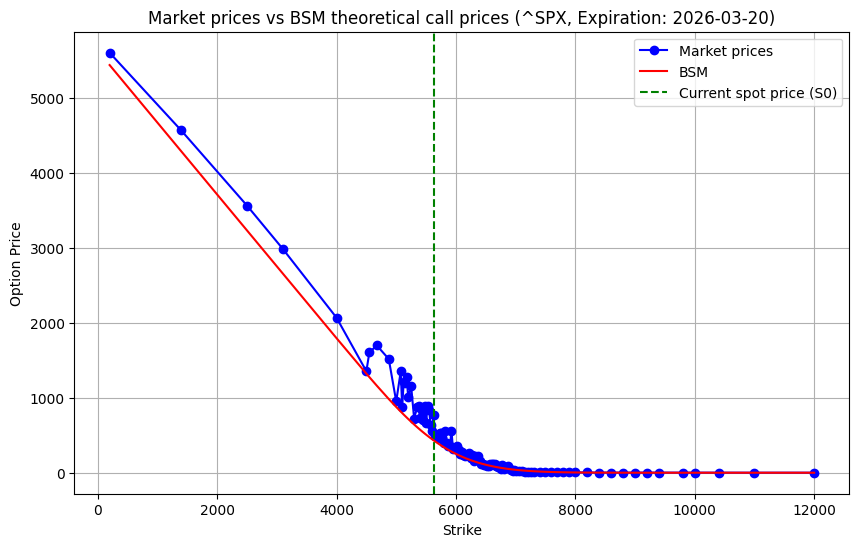

In [47]:
import yfinance as yf
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime

# Classe BlackScholes
class BlackScholes:
    def __init__(self, r, S, K, T, sigma, option_type="C"):
        self.r = r
        self.S = S
        self.K = K
        self.T = T
        self.sigma = sigma
        self.option_type = option_type

    def calculate_d1_d2(self):
        d1 = (np.log(self.S / self.K) + (self.r + self.sigma**2 / 2) * self.T) / (self.sigma * np.sqrt(self.T))
        d2 = d1 - self.sigma * np.sqrt(self.T)
        return d1, d2

    def calculate_option_price(self):
        d1, d2 = self.calculate_d1_d2()
        if self.option_type == "C":
            price = self.S * norm.cdf(d1) - self.K * np.exp(-self.r * self.T) * norm.cdf(d2)
        elif self.option_type == "P":
            price = self.K * np.exp(-self.r * self.T) * norm.cdf(-d2) - self.S * norm.cdf(-d1)
        else:
            raise ValueError("Invalid option type. Use 'C' for Call or 'P' for Put.")
        return price

# Récupérer les données de marché
ticker = "^SPX"
expiration_date = "2026-03-20"
spx = yf.Ticker(ticker)
options = spx.option_chain(expiration_date)
calls = options.calls

# Paramètres
S0 = calibration.get_latest_price()  # Prix actuel de l'actif sous-jacent
r = calibration.get_risk_free_rate()  # Taux sans risque
T = (datetime.strptime(expiration_date, "%Y-%m-%d") - datetime.now()).days / 365  # Temps jusqu'à l'échéance
hist_sigma = calibration.get_historical_sigma()  # Volatilité historique

# Calculer les prix théoriques des calls avec le modèle Black-Scholes
calls['Theoretical Price'] = calls.apply(
    lambda row: BlackScholes(
        r=r,
        S=S0,
        K=row['strike'],
        T=T,
        sigma=hist_sigma,
        option_type="C"
    ).calculate_option_price(),
    axis=1
)

# Tracer les deux courbes
plt.figure(figsize=(10, 6))
plt.plot(calls['strike'], calls['lastPrice'], 'bo-', label='Market prices')
plt.plot(calls['strike'], calls['Theoretical Price'], 'r', label='BSM')
plt.axvline(x=S0, color='g', linestyle='--', label='Current spot price (S0)')
plt.title(f'Market prices vs BSM theoretical call prices ({ticker}, Expiration: {expiration_date})')
plt.xlabel('Strike')
plt.ylabel('Option Price')
plt.legend()
plt.grid()
plt.show()

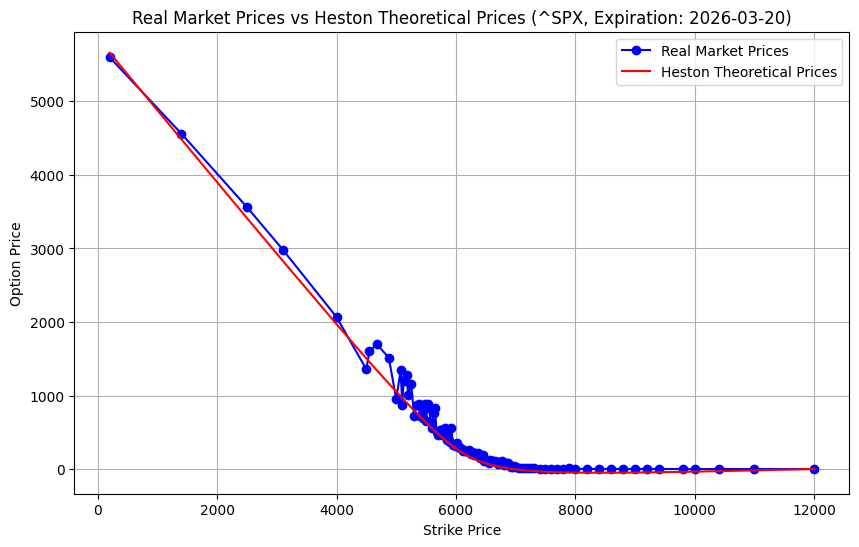

In [46]:
import yfinance as yf
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime
import pandas as pd

# Fetch real market prices
ticker = "^SPX"
expiration_date = "2026-03-20"
spx = yf.Ticker(ticker)
options = spx.option_chain(expiration_date)
calls = options.calls

# Parameters
S0 = calibration.get_latest_price()  # Current price of the underlying asset
r = calibration.get_risk_free_rate()  # Risk-free rate
T = (datetime.strptime(expiration_date, "%Y-%m-%d") - datetime.now()).days / 365  # Time to maturity in years

# Calibrated Heston parameters (from your CSV file)
params_df = pd.read_csv("data/heston_calibrated_parameters.csv")
v0 = params_df["v0"].iloc[0]
kappa = params_df["kappa"].iloc[0]
theta = params_df["theta"].iloc[0]
sigma_heston = params_df["sigma"].iloc[0]
rho_heston = params_df["rho"].iloc[0]
lambd = params_df["lambd"].iloc[0]

# Calculate theoretical prices using the Heston model
calls['Heston Theoretical Price'] = calls.apply(
    lambda row: Heston(
        S0=S0,
        K=row['strike'],
        r=r,
        T=T,
        option_type="C",
        v0=v0,
        kappa=kappa,
        theta=theta,
        sigma=sigma_heston,
        rho=rho_heston,
        lambd=lambd
    ).calculate_option_price(),
    axis=1
)

# Plot the real market prices and Heston theoretical prices
plt.figure(figsize=(10, 6))
plt.plot(calls['strike'], calls['lastPrice'], 'bo-', label='Real Market Prices')
plt.plot(calls['strike'], calls['Heston Theoretical Price'], 'r', label='Heston Theoretical Prices')
plt.title(f'Real Market Prices vs Heston Theoretical Prices ({ticker}, Expiration: {expiration_date})')
plt.xlabel('Strike Price')
plt.ylabel('Option Price')
plt.legend()
plt.grid()
plt.show()

In [2]:
from models import BlackScholes, MonteCarlo, Heston, Dupire, SABR
from calibration import Calibration
from visualization.graphics import Graphics
import datetime as dt
import pandas as pd
import numpy as np
ticker = '^SPX'
end  = dt.datetime.now()
start = end - dt.timedelta(days=180) # 180 days is common when you consider the volatility constant
calibration = Calibration(ticker, start, end)
spx_historical_prices = calibration.get_historical_prices_df()

S0 = calibration.get_latest_price()
K = S0 # Strike price
T = 1  # Time to maturity (1 year)
hist_mu = calibration.get_historical_mu()
hist_sigma = calibration.get_historical_sigma()
r = calibration.get_risk_free_rate()

YF.download() has changed argument auto_adjust default to True


In [3]:
# Load the calibrated parameters from the CSV file
params_df = pd.read_csv("data/heston_calibrated_parameters.csv")

# Extract the parameters
v0 = params_df["v0"].iloc[0]
kappa = params_df["kappa"].iloc[0]
theta = params_df["theta"].iloc[0]
sigma_heston = params_df["sigma"].iloc[0]
rho_heston = params_df["rho"].iloc[0]
lambd = params_df["lambd"].iloc[0]
#calibration_date = params_df["calibration_date"].iloc[0]

In [4]:
# Retrieve the Treasury yield curve data
NSS_curve = calibration.get_treasury_yield_curve()

# Fetch the options data for the specified ticker and date range
volSurfaceLong = calibration.get_options_dataframe()

# Calculate the risk-free rates for each option's time to maturity using the Treasury yield curve
volSurfaceLong['rate'] = volSurfaceLong['tenor'].apply(NSS_curve)

In [5]:
volSurfaceLong

,tenor,strike,price,rate
0,-0.000142,3000.0,2746.00,0.042448
1,-0.000142,4400.0,1282.69,0.042448
2,-0.000142,4600.0,1008.00,0.042448
3,-0.000142,4700.0,946.90,0.042448
4,-0.000142,4800.0,875.19,0.042448
...,...,...,...,...
7735,5.783419,8600.0,427.71,0.040262
7736,5.783419,9000.0,410.00,0.040262
7737,5.783419,10000.0,150.00,0.040262
7738,5.783419,11000.0,230.92,0.040262


In [6]:
def calculate_heston_prices(row):
    heston_model = Heston(
        S0=S0,
        K=row['strike'],
        r=r,
        T=row['tenor'],
        v0=v0,
        kappa=kappa,
        theta=theta,
        sigma=sigma_heston,
        rho=rho_heston,
        lambd=lambd,
        option_type="C"
    )
    return heston_model.calculate_option_price()

In [7]:
volSurfaceLong['heston_price'] = volSurfaceLong.apply(calculate_heston_prices, axis=1)

/Users/jonathanlevel/Desktop/Scolaire/Supérieur/TSP/3A/PFE/Option_Pricing/models/heston.py:113: RuntimeWarning: overflow encountered in exp
  return np.exp(a*self.T*(b-rspi+d)/self.sigma**2 + self.v0*(b-rspi+d)*( (1-np.exp(d*self.T))/(1-g*np.exp(d*self.T)) )/self.sigma**2)
/Users/jonathanlevel/Desktop/Scolaire/Supérieur/TSP/3A/PFE/Option_Pricing/models/heston.py:113: RuntimeWarning: invalid value encountered in scalar multiply
  return np.exp(a*self.T*(b-rspi+d)/self.sigma**2 + self.v0*(b-rspi+d)*( (1-np.exp(d*self.T))/(1-g*np.exp(d*self.T)) )/self.sigma**2)
/Users/jonathanlevel/Desktop/Scolaire/Supérieur/TSP/3A/PFE/Option_Pricing/models/heston.py:113: RuntimeWarning: invalid value encountered in scalar divide
  return np.exp(a*self.T*(b-rspi+d)/self.sigma**2 + self.v0*(b-rspi+d)*( (1-np.exp(d*self.T))/(1-g*np.exp(d*self.T)) )/self.sigma**2)
/Users/jonathanlevel/Desktop/Scolaire/Supérieur/TSP/3A/PFE/Option_Pricing/models/heston.py:113: RuntimeWarning: overflow encountered in scalar

In [8]:
import pandas as pd
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode

# Initialize notebook mode for Plotly
init_notebook_mode()

In [10]:
# Plot the 3D surface
fig = go.Figure(data=[go.Mesh3d(
    x=volSurfaceLong['tenor'],
    y=volSurfaceLong['strike'],
    z=volSurfaceLong['price'],
    color='mediumblue',
    opacity=0.55
)])

fig.add_scatter3d(
    x=volSurfaceLong['tenor'],
    y=volSurfaceLong['strike'],
    z=volSurfaceLong['heston_price'],
    mode='markers'
)

fig.update_layout(
    title_text='Market Prices (Mesh) vs Calibrated Heston Prices (Markers)',
    scene=dict(
        xaxis_title='TIME (Years)',
        yaxis_title='STRIKES (Pts)',
        zaxis_title='INDEX OPTION PRICE (Pts)'
    ),
    height=800,
    width=800
)

fig.show(renderer="notebook")

In [12]:
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode

# Initialize notebook mode for Plotly
init_notebook_mode()

# Create the 3D mesh for market prices
mesh = go.Mesh3d(
    x=volSurfaceLong['tenor'],
    y=volSurfaceLong['strike'],
    z=volSurfaceLong['price'],
    color='mediumblue',
    opacity=0.55,
    name='Market Prices'  # Add a name for the legend
)

# Create the 3D scatter plot for Heston prices
scatter = go.Scatter3d(
    x=volSurfaceLong['tenor'],
    y=volSurfaceLong['strike'],
    z=volSurfaceLong['heston_price'],
    mode='markers',
    marker=dict(
        color='red',
        size=5
    ),
    name='Heston Prices'  # Add a name for the legend
)

# Create the figure
fig = go.Figure(data=[mesh, scatter])

# Add a caption as an annotation
fig.add_annotation(
    x=0.5,  # X position of the caption (0.5 = middle of the plot)
    y=1.1,  # Y position of the caption (1.1 = above the plot)
    xref='paper',  # Use relative coordinates for the X position
    yref='paper',  # Use relative coordinates for the Y position
    text="<b>Market Prices (Blue Mesh)</b> vs <b>Heston Prices (Red Dots)</b>",  # Caption text
    showarrow=False,  # Don't show an arrow
    font=dict(
        size=14,
        color="black"
    )
)

# Update the layout
fig.update_layout(
    scene=dict(
        xaxis_title='TIME (Years)',
        yaxis_title='STRIKES (Pts)',
        zaxis_title='INDEX OPTION PRICE (Pts)'
    ),
    height=800,
    width=800,
    legend=dict(
        x=0.8,  # Position of the legend
        y=0.9,  # Position of the legend
        bgcolor='rgba(255, 255, 255, 0.5)'  # Semi-transparent background
    )
)

# Show the plot
fig.show(renderer="notebook")